# Pix2Pix Ablation Study - Results Visualization

Comparing different hyperparameter configurations for manga colorization.

**Dataset:** 1281 anime images randomly sampled from danbooru full-body dataset, split into 1024 training + 257 validation.

**Experiments:**
- Baseline: 256px, bs=16, lr=0.0002, L1=100
- Batch Size 32: increased batch size
- LR 0.0004: doubled learning rate
- L1 Weight 200: doubled L1 reconstruction weight

In [6]:
"""Setup environment."""
import os

# No need to change directory, just use relative paths
print(f"Current directory: {os.getcwd()}")


working dir: /Users/zhaomingming/Desktop/MangaColorization


In [7]:
import torch
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

from model import UNetGenerator

device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")
print(f"using: {device}")

# transforms
gray_transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.Grayscale(num_output_channels=1),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

using: mps


In [8]:
def load_generator(checkpoint_path):
    G = UNetGenerator().to(device)
    G.load_state_dict(torch.load(checkpoint_path, map_location=device, weights_only=True))
    G.eval()
    return G

def generate_image(G, img_path):
    img = Image.open(img_path).convert('RGB')
    gray = gray_transform(img).unsqueeze(0).to(device)
    with torch.no_grad():
        fake = G(gray)
    fake = fake.squeeze().cpu().numpy().transpose(1, 2, 0)
    fake = (fake * 0.5 + 0.5).clip(0, 1)
    return fake

---
## 1. Loss Curves Comparison

Comparing validation generator loss across all experiments.

In [9]:
experiments = {    'Baseline': '../experiments/baseline/loss_history.csv',    'Batch Size 32': '../experiments/batch_size_32/loss_history.csv',    'LR 0.0004': '../experiments/lr_0004/loss_history.csv',    'L1 Weight 200': '../experiments/l1_200/loss_history.csv'}# load and display final resultsresults = []for name, path in experiments.items():    try:        df = pd.read_csv(path)        final = df.iloc[-1]        results.append({            'Experiment': name,            'Train G Loss': f"{final['train_G_loss']:.2f}",            'Val G Loss': f"{final['val_G_loss']:.2f}"        })    except Exception as e:        print(f"couldn't load {path}: {e}")print("Final Results (100 epochs):")print(pd.DataFrame(results).to_string(index=False))

Final Results (100 epochs):
   Experiment Train G Loss Val G Loss
     Baseline         3.53       9.20
Batch Size 32         3.96       9.11
    LR 0.0004         4.14       9.27
L1 Weight 200         7.11      18.44


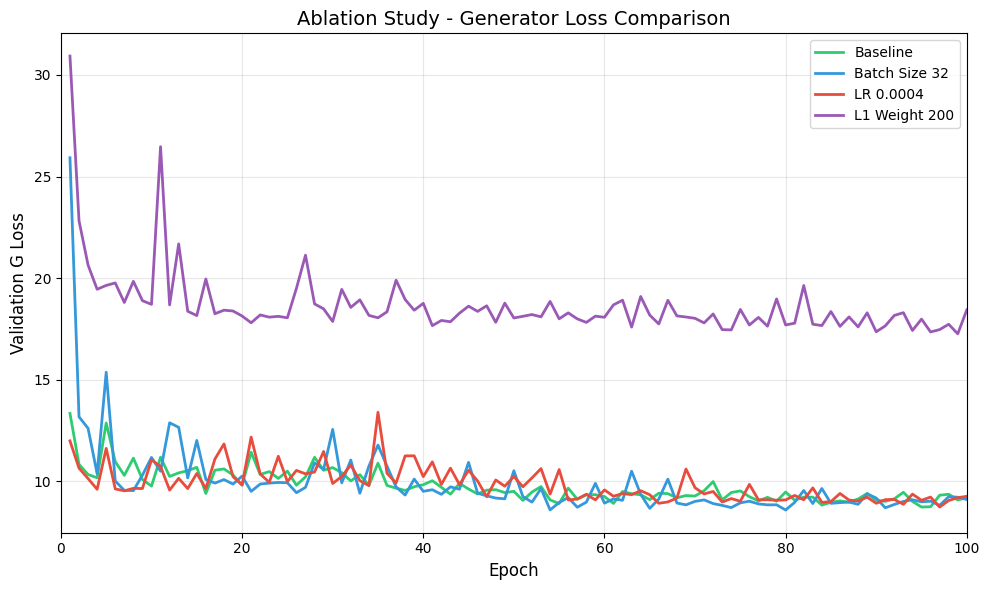

In [10]:
# plot loss curvesfig, ax = plt.subplots(figsize=(10, 6))colors = ['#2ecc71', '#3498db', '#e74c3c', '#9b59b6']for (name, path), color in zip(experiments.items(), colors):    try:        df = pd.read_csv(path)        ax.plot(df['epoch'], df['val_G_loss'], label=name, linewidth=2, color=color)    except:        passax.set_xlabel('Epoch', fontsize=12)ax.set_ylabel('Validation G Loss', fontsize=12)ax.set_title('Ablation Study - Generator Loss Comparison', fontsize=14)ax.legend(loc='upper right', fontsize=10)ax.grid(True, alpha=0.3)ax.set_xlim(0, 100)plt.tight_layout()plt.savefig('../experiments/loss_comparison.png', dpi=150, bbox_inches='tight')plt.show()

---
## 2. Side-by-Side Comparison (All Experiments)

Comparing output from all 4 experiments on the same input images.

In [11]:
def compare_all_experiments(start_idx=0, n_images=5):    """    show same images across all experiments for direct comparison    columns: input | baseline | batch32 | lr0004 | l1_200 | ground truth    """    checkpoints = {        'Baseline': 'experiments/baseline/checkpoints/G_final.pth',        'Batch 32': 'experiments/batch_size_32/checkpoints/G_final.pth',        'LR 0.0004': 'experiments/lr_0004/checkpoints/G_final.pth',        'L1 200': 'experiments/l1_200/checkpoints/G_final.pth'    }        # load all generators    generators = {name: load_generator(path) for name, path in checkpoints.items()}        val_dir = '../data/val'    val_images = sorted(os.listdir(val_dir))[start_idx:start_idx+n_images]        fig, axes = plt.subplots(n_images, 6, figsize=(18, n_images * 3))        col_titles = ['Input', 'Baseline', 'Batch 32', 'LR 0.0004', 'L1 200', 'Ground Truth']        for i, img_name in enumerate(val_images):        img_path = f'{val_dir}/{img_name}'        img = Image.open(img_path).convert('RGB')        img_resized = img.resize((256, 256))                # input (grayscale)        gray_img = img_resized.convert('L')        axes[i, 0].imshow(gray_img, cmap='gray')        axes[i, 0].axis('off')        if i == 0:            axes[i, 0].set_title(col_titles[0], fontsize=11)                # each experiment        for j, (name, G) in enumerate(generators.items()):            fake = generate_image(G, img_path)            axes[i, j+1].imshow(fake)            axes[i, j+1].axis('off')            if i == 0:                axes[i, j+1].set_title(col_titles[j+1], fontsize=11)                # ground truth        axes[i, 5].imshow(img_resized)        axes[i, 5].axis('off')        if i == 0:            axes[i, 5].set_title(col_titles[5], fontsize=11)        plt.suptitle(f'Experiment Comparison (Images {start_idx+1}-{start_idx+n_images})', fontsize=14, y=1.02)    plt.tight_layout()    plt.savefig(f'experiments/comparison_imgs_{start_idx+1}_{start_idx+n_images}.png', dpi=150, bbox_inches='tight')    plt.show()

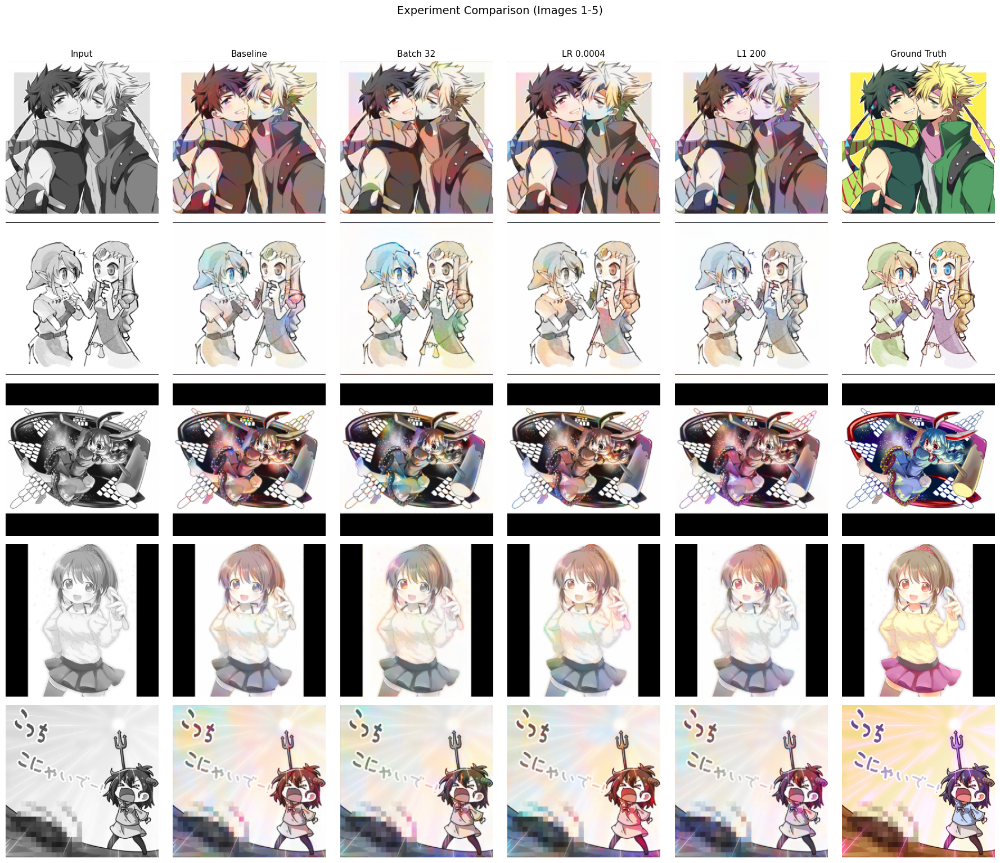

In [12]:
# images 1-5
compare_all_experiments(start_idx=0, n_images=5)

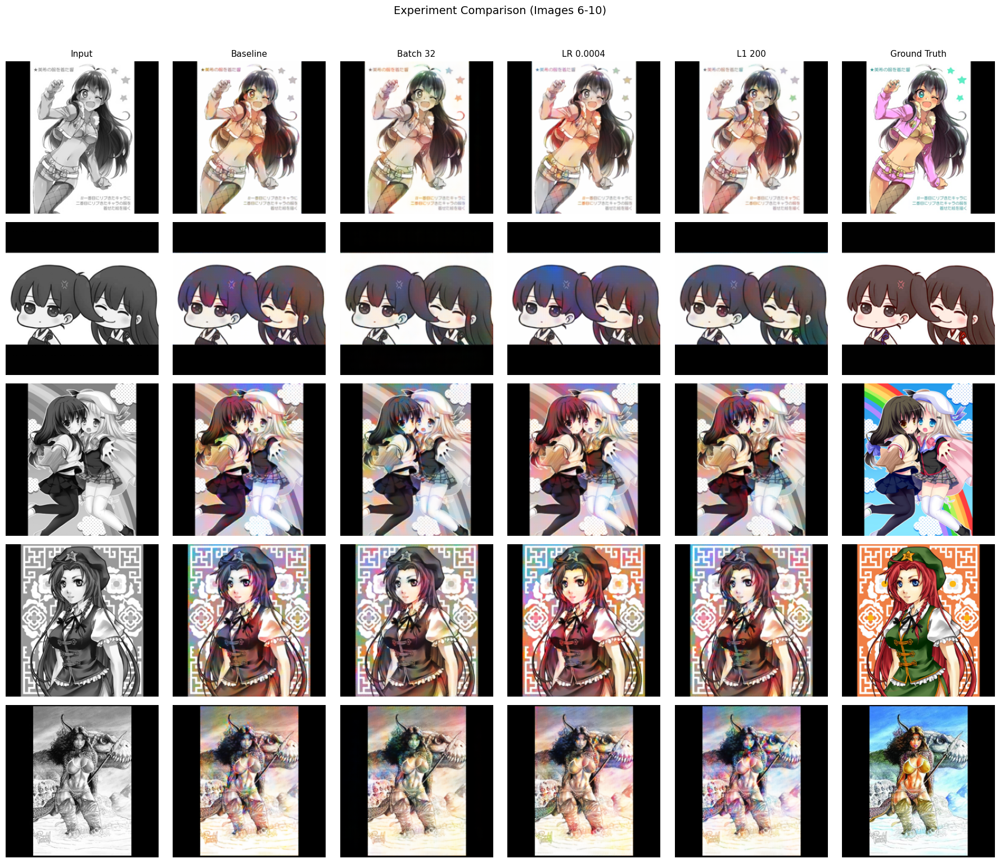

In [13]:
# images 6-10
compare_all_experiments(start_idx=5, n_images=5)

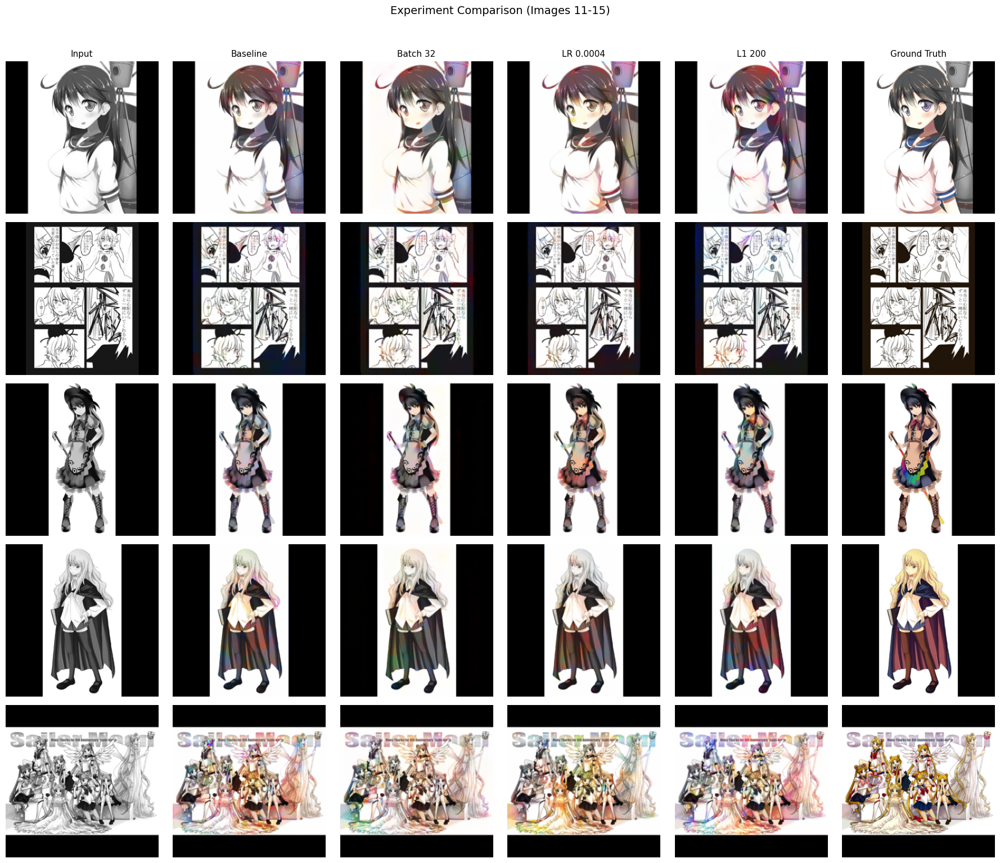

In [14]:
# images 11-15
compare_all_experiments(start_idx=10, n_images=5)

---
## 3. Grid View - Each Experiment

25 generated samples from each experiment.

In [15]:
def show_grid(checkpoint_path, title, start=0, n_images=25):    G = load_generator(checkpoint_path)        val_dir = '../data/val'    val_images = sorted(os.listdir(val_dir))[start:start+n_images]        cols = 5    rows = (len(val_images) + cols - 1) // cols        fig, axes = plt.subplots(rows, cols, figsize=(12, rows * 2.5))    axes = axes.flatten()        for i, img_name in enumerate(val_images):        fake = generate_image(G, f'{val_dir}/{img_name}')        axes[i].imshow(fake)        axes[i].axis('off')        for i in range(len(val_images), len(axes)):        axes[i].axis('off')        plt.suptitle(title, fontsize=14)    plt.tight_layout()    plt.show()

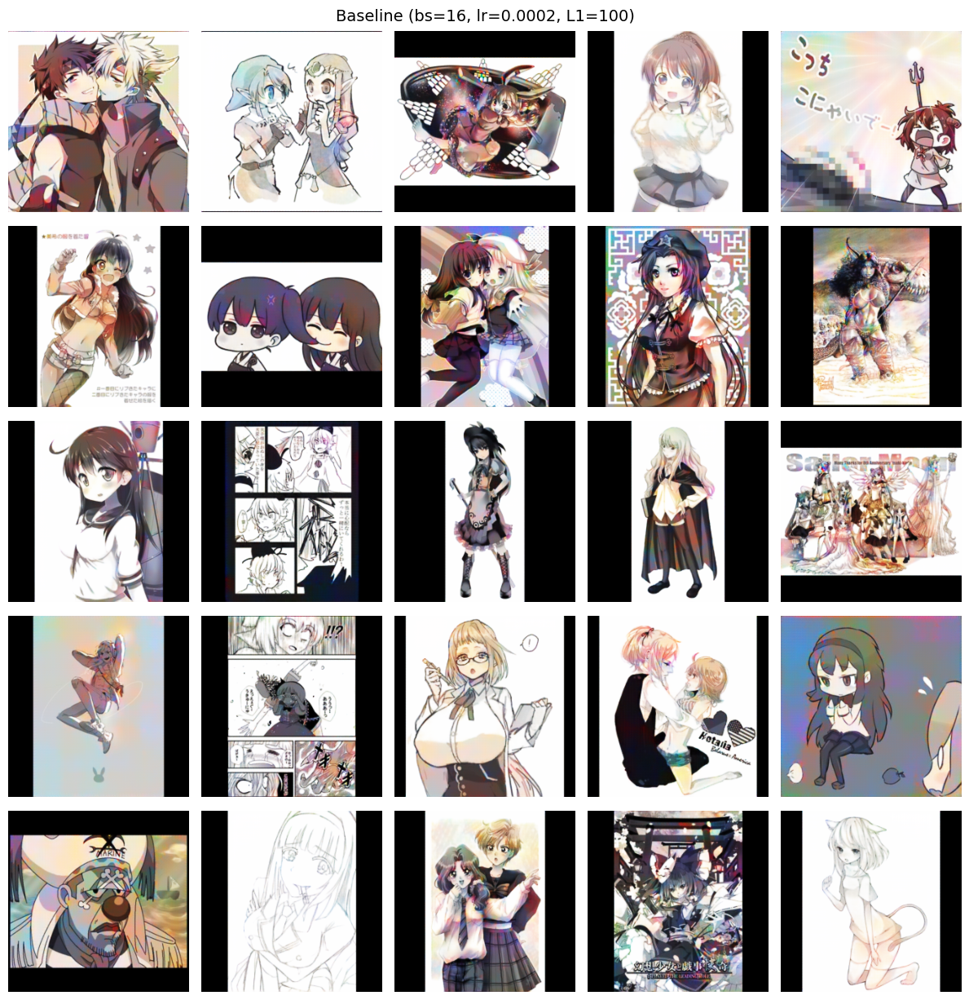

In [16]:
show_grid('../experiments/baseline/checkpoints/G_final.pth', 'Baseline (bs=16, lr=0.0002, L1=100)')

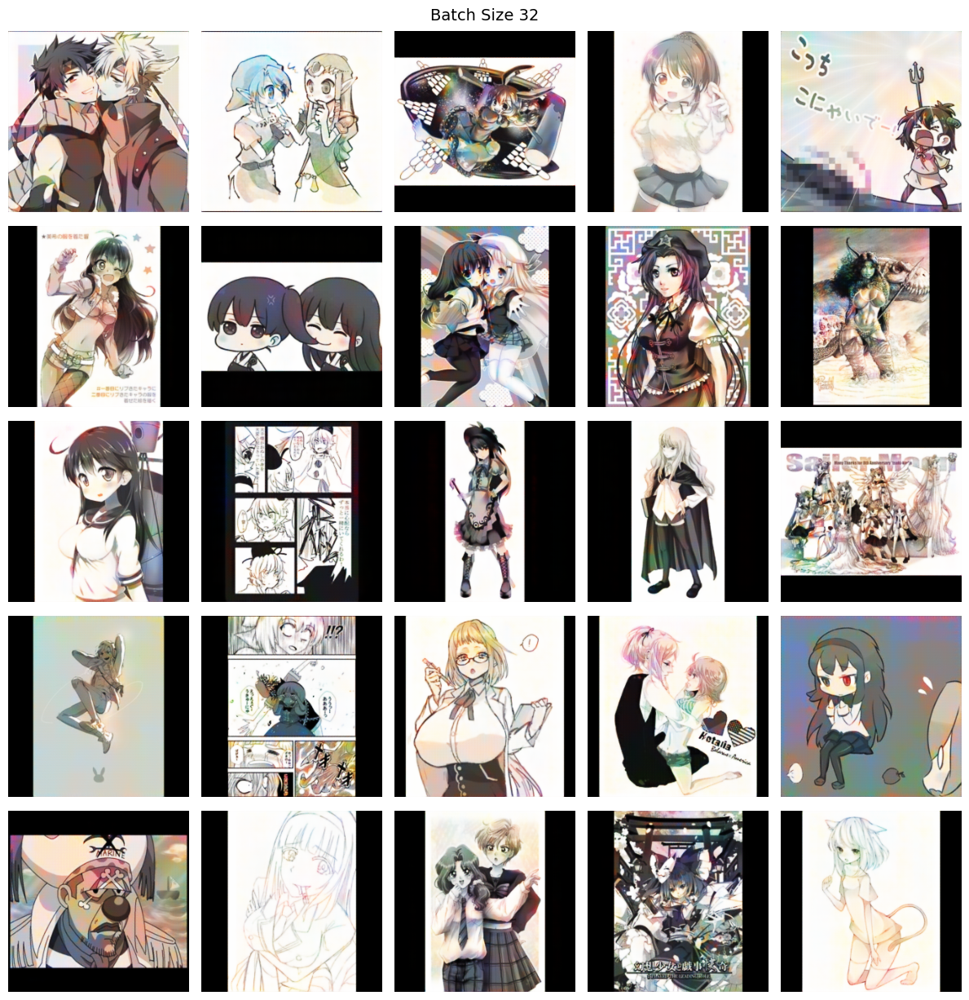

In [17]:
show_grid('../experiments/batch_size_32/checkpoints/G_final.pth', 'Batch Size 32')

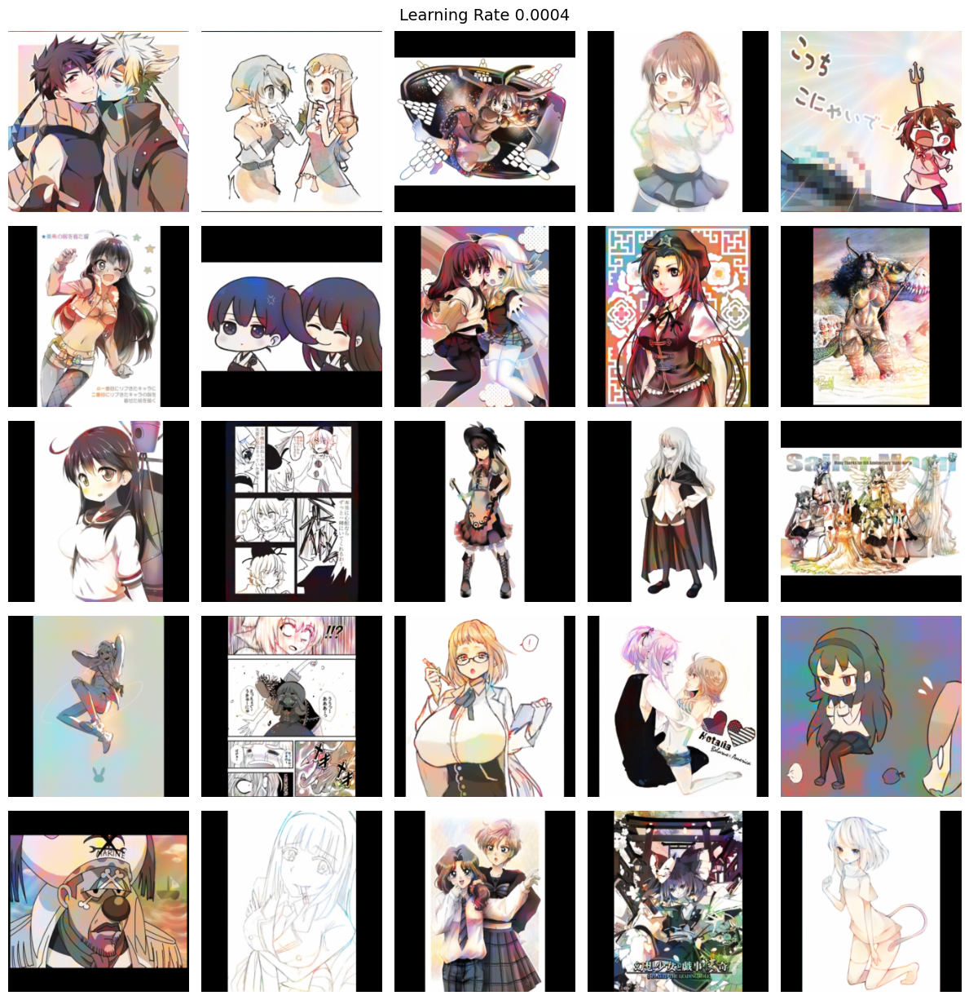

In [18]:
show_grid('../experiments/lr_0004/checkpoints/G_final.pth', 'Learning Rate 0.0004')

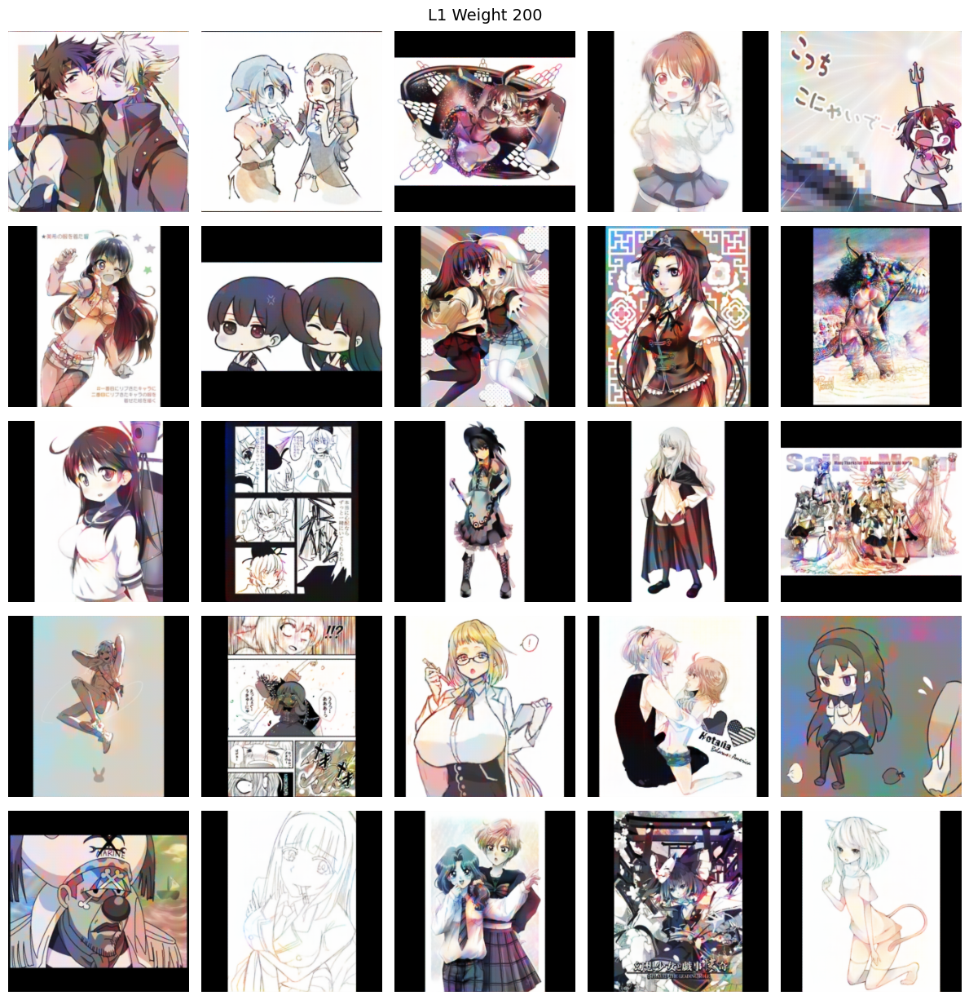

In [19]:
show_grid('../experiments/l1_200/checkpoints/G_final.pth', 'L1 Weight 200')

---
## 4. Detailed Comparison (Input / Output / Ground Truth)

Closer look at individual results.

In [20]:
def detailed_comparison(checkpoint_path, title, start=0, n_images=5):    G = load_generator(checkpoint_path)        val_dir = '../data/val'    val_images = sorted(os.listdir(val_dir))[start:start+n_images]        fig, axes = plt.subplots(n_images, 3, figsize=(10, n_images * 3.2))        for i, img_name in enumerate(val_images):        img_path = f'{val_dir}/{img_name}'        img = Image.open(img_path).convert('RGB')        img_resized = img.resize((256, 256))                fake = generate_image(G, img_path)        gray_img = img_resized.convert('L')                axes[i, 0].imshow(gray_img, cmap='gray')        axes[i, 0].axis('off')        if i == 0:            axes[i, 0].set_title('Input (Grayscale)', fontsize=11)                axes[i, 1].imshow(fake)        axes[i, 1].axis('off')        if i == 0:            axes[i, 1].set_title('Generated', fontsize=11)                axes[i, 2].imshow(img_resized)        axes[i, 2].axis('off')        if i == 0:            axes[i, 2].set_title('Ground Truth', fontsize=11)        plt.suptitle(title, fontsize=14)    plt.tight_layout()    plt.show()

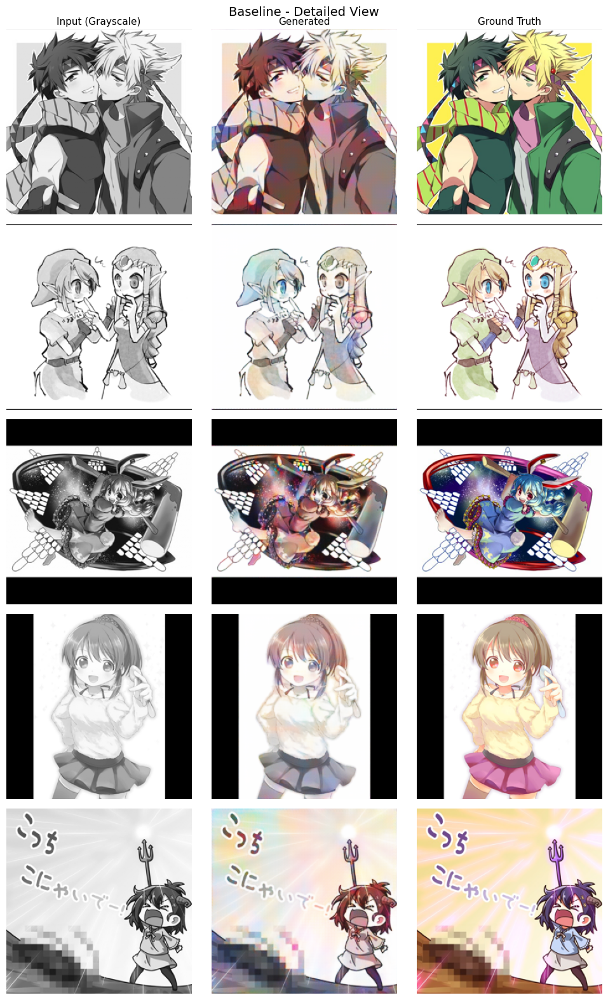

In [21]:
detailed_comparison('../experiments/baseline/checkpoints/G_final.pth', 'Baseline - Detailed View')

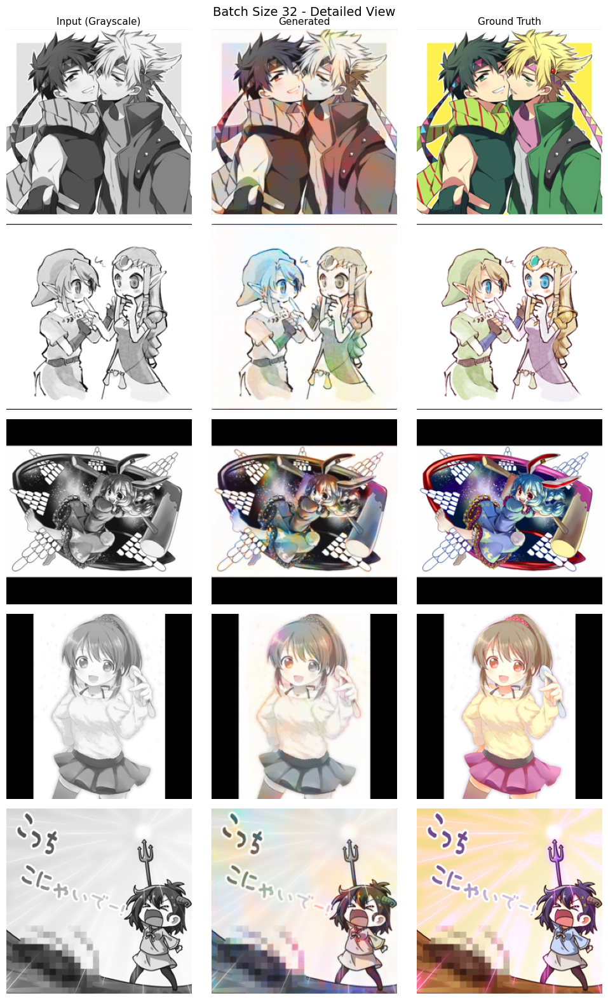

In [22]:
detailed_comparison('../experiments/batch_size_32/checkpoints/G_final.pth', 'Batch Size 32 - Detailed View')

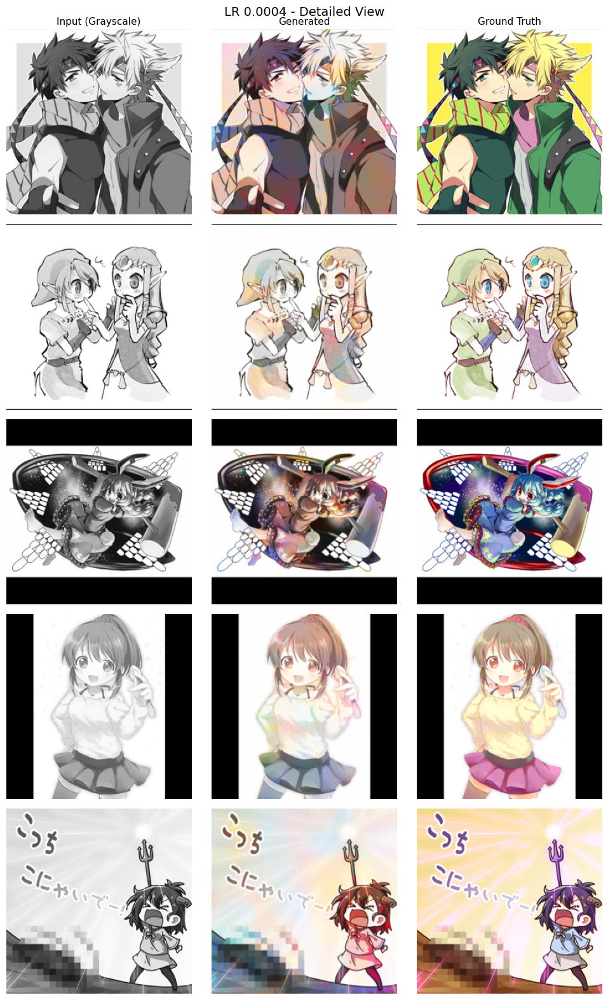

In [23]:
detailed_comparison('../experiments/lr_0004/checkpoints/G_final.pth', 'LR 0.0004 - Detailed View')

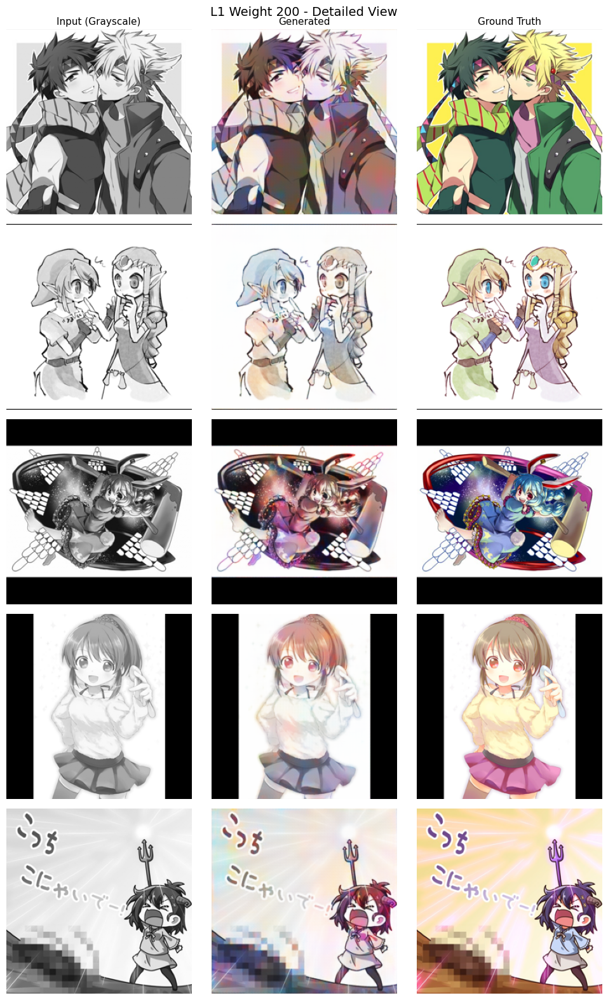

In [24]:
detailed_comparison('../experiments/l1_200/checkpoints/G_final.pth', 'L1 Weight 200 - Detailed View')

---
## 5. Training Progress (Baseline)

How the baseline model improves over training epochs.

In [25]:
def show_training_progress(n_images=5):    checkpoints = [        ('Epoch 25', 'experiments/baseline/checkpoints/G_epoch_25.pth'),        ('Epoch 50', 'experiments/baseline/checkpoints/G_epoch_50.pth'),        ('Epoch 75', 'experiments/baseline/checkpoints/G_epoch_75.pth'),        ('Epoch 100', 'experiments/baseline/checkpoints/G_final.pth')    ]        generators = [(name, load_generator(path)) for name, path in checkpoints]        val_dir = '../data/val'    val_images = sorted(os.listdir(val_dir))[:n_images]        fig, axes = plt.subplots(n_images, 6, figsize=(16, n_images * 2.8))        col_titles = ['Input', 'Epoch 25', 'Epoch 50', 'Epoch 75', 'Epoch 100', 'Ground Truth']        for i, img_name in enumerate(val_images):        img_path = f'{val_dir}/{img_name}'        img = Image.open(img_path).convert('RGB')        img_resized = img.resize((256, 256))                gray_img = img_resized.convert('L')        axes[i, 0].imshow(gray_img, cmap='gray')        axes[i, 0].axis('off')        if i == 0:            axes[i, 0].set_title(col_titles[0], fontsize=11)                for j, (name, G) in enumerate(generators):            fake = generate_image(G, img_path)            axes[i, j+1].imshow(fake)            axes[i, j+1].axis('off')            if i == 0:                axes[i, j+1].set_title(col_titles[j+1], fontsize=11)                axes[i, 5].imshow(img_resized)        axes[i, 5].axis('off')        if i == 0:            axes[i, 5].set_title(col_titles[5], fontsize=11)        plt.suptitle('Training Progress - Baseline Model', fontsize=14, y=1.02)    plt.tight_layout()    plt.savefig('experiments/training_progress.png', dpi=150, bbox_inches='tight')    plt.show()

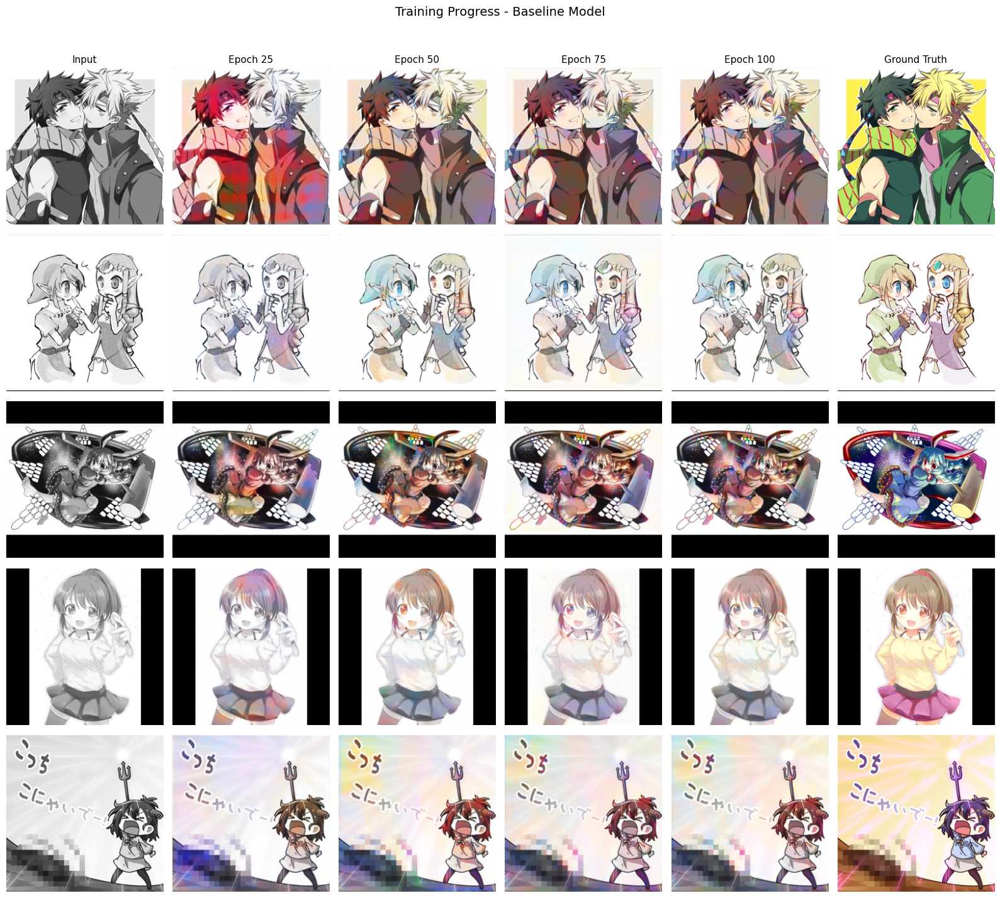

In [26]:
show_training_progress(n_images=5)

---
## Summary

### Key Findings

| Experiment | Val G Loss | Observation |
|------------|------------|-------------|
| Baseline | ~9.0 | Stable training, good results |
| Batch Size 32 | ~9.0 | Similar to baseline, slightly faster convergence |
| LR 0.0004 | ~9.0 | More fluctuation during training, similar final result |
| L1 Weight 200 | ~18.0 | Significantly worse, too much emphasis on pixel accuracy |

### Conclusions

1. **Baseline configuration works well** - The default pix2pix settings (bs=16, lr=0.0002, L1=100) produce stable training and good colorization results.

2. **Batch size has minimal impact** - Increasing batch size to 32 doesn't significantly change the results, just slightly more stable gradients.

3. **Higher learning rate is less stable** - Doubling the learning rate causes more fluctuation but converges to similar results.

4. **L1 weight is sensitive** - Doubling L1 weight hurts performance significantly. The model becomes too focused on pixel-level reconstruction and loses the adversarial learning benefit.